# Food Image Recognition

In [1]:
# ==== Standard Libraries ====
import os
import warnings
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
import cv2

# ==== TensorFlow and Keras (safe way) ====
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import *
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.optimizers import Adam, Adamax
from tensorflow.keras.applications import *
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# ==== Scikit-learn ====
from sklearn.preprocessing import LabelEncoder

# ==== Other ====
warnings.filterwarnings("ignore")
palette = ["#606060FF", "#D6ED17FF"]


Load Data

In [2]:
# Load Data and Make DataFrame
def L_Data(directory):
    filepath =[]
    label = []

    folds = os.listdir(directory)

    for fold in folds:
        f_path = os.path.join(directory , fold)

        imgs = os.listdir(f_path)

        for img in imgs:

            img_path = os.path.join(f_path , img)
            filepath.append(img_path)
            label.append(fold)

    #Concat data paths with labels
    file_path_series = pd.Series(filepath , name= 'filepath')
    Label_path_series = pd.Series(label , name = 'label')
    df_train = pd.concat([file_path_series ,Label_path_series ] , axis = 1)
    
    return df_train
# # Directory containing the "Train" folder
directory_T = "D:\Private\Prodigy InfoTech\Task 5\Train"
# Directory containing the "Test" folder
directory_TE = "D:\Private\Prodigy InfoTech\Task 5\Test"
# Train Data and Test Data 
tr_d = L_Data(directory_T)
te_d = L_Data(directory_TE)

In [3]:
# Shape
print(f"The shape of The Train data is: {tr_d.shape}")
print(f"The shape of The Test data is: {te_d.shape}")

The shape of The Train data is: (17748, 2)
The shape of The Test data is: (1700, 2)


Train and Test Dataset Generator

In [4]:
#Data_Dir Train And Test
test_dir = directory_TE
data_dir = "D:\Private\Prodigy InfoTech\Task 5\Train"

# Image Size
IMAGE_SIZE = (256, 256)

print('Training Images:')
# creating the training dataset
train_ds = tf.keras.utils.image_dataset_from_directory(
    data_dir,
    validation_split=0.2,
    subset='training',
    seed=123,
    image_size=IMAGE_SIZE,
    batch_size=32)

#Testing Augmented Data
print('Validation Images:')
validation_ds = tf.keras.utils.image_dataset_from_directory(
    data_dir, 
    validation_split=0.2,
    subset='validation',
    seed=123,
    image_size=IMAGE_SIZE,
    batch_size=32)

# Create an ImageDataGenerator instance without augmentation
test_datagen = ImageDataGenerator(rescale=1.0/255.0)  

# Load test data using ImageDataGenerator
test_ds = test_datagen.flow_from_directory(
    test_dir,
    target_size=IMAGE_SIZE,  
    batch_size=32,
    class_mode='categorical',  
    shuffle=False ,
)

Training Images:
Found 17748 files belonging to 17 classes.
Using 14199 files for training.
Validation Images:
Found 17748 files belonging to 17 classes.
Using 3549 files for validation.
Found 1700 images belonging to 17 classes.


Normalizing Pixel Value

In [5]:
# Normalizing Pixel Values 
# Train Data 
train_ds = train_ds.map(lambda x, y: (x / 255.0, y))
# Val Data
validation_ds = validation_ds.map(lambda x, y: (x / 255.0, y))

Train and Test Images

In [20]:
def visualize_images(path, num_images=5):
    # Filter for common image formats
    valid_exts = ('.png', '.jpg', '.jpeg', '.bmp', '.tiff')
    image_filenames = [f for f in os.listdir(path) if f.lower().endswith(valid_exts)]

    if not image_filenames:
        print("No valid image files found in the specified directory.")
        return

    # Limit to available number of images
    num_images = min(num_images, len(image_filenames))
    
    # Create subplots
    fig, axes = plt.subplots(1, num_images, figsize=(4 * num_images, 4), facecolor='white')
    if num_images == 1:
        axes = [axes]  # Make axes iterable

    for i in range(num_images):
        image_path = os.path.join(path, image_filenames[i])
        try:
            image = Image.open(image_path)
            axes[i].imshow(image)
            axes[i].axis('off')
            axes[i].set_title(image_filenames[i], fontsize=10)
        except Exception as e:
            axes[i].text(0.5, 0.5, "Error\nLoading Image", ha='center', va='center')
            axes[i].axis('off')
            print(f"Error loading {image_filenames[i]}: {e}")

    plt.tight_layout()
    plt.show()

apple_pie

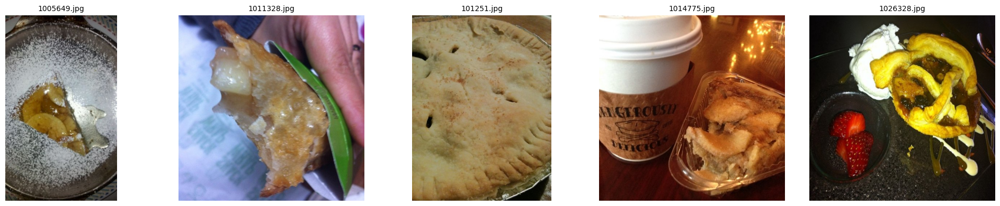

In [21]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/apple_pie"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

Baked Potato

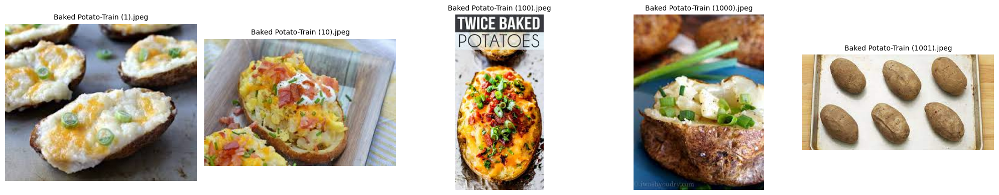

In [22]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/Baked Potato"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

burger

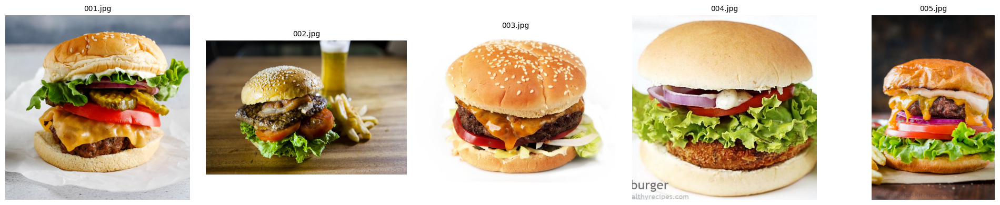

In [23]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/burger"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

cheesecake

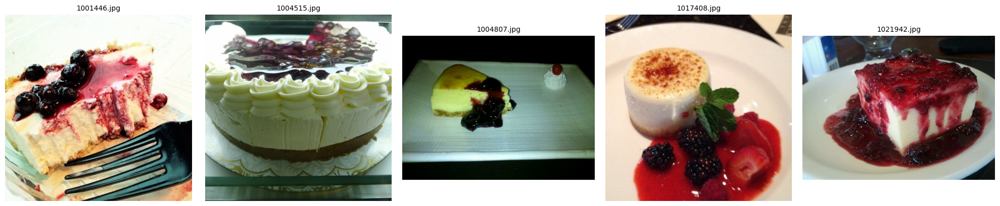

In [24]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/cheesecake"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

chicken_curry

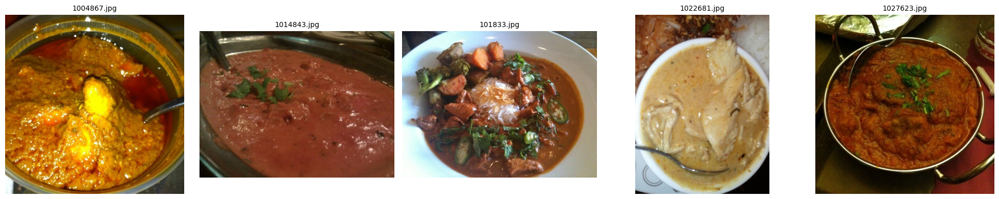

In [25]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/chicken_curry"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

Crispy Chicken

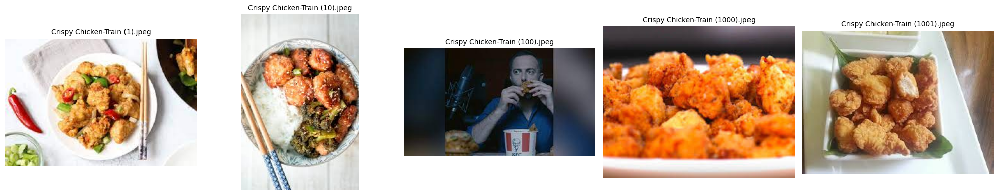

In [26]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/Crispy Chicken"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

Donut

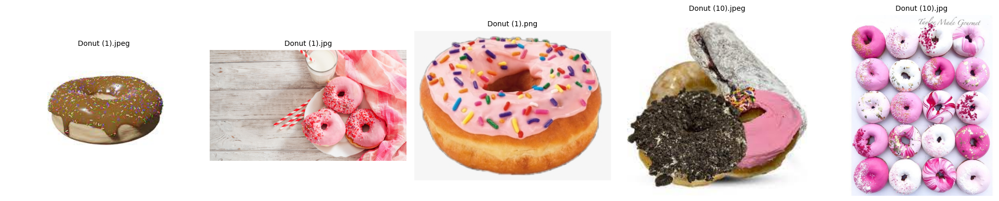

In [27]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/Donut"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

fried_rice

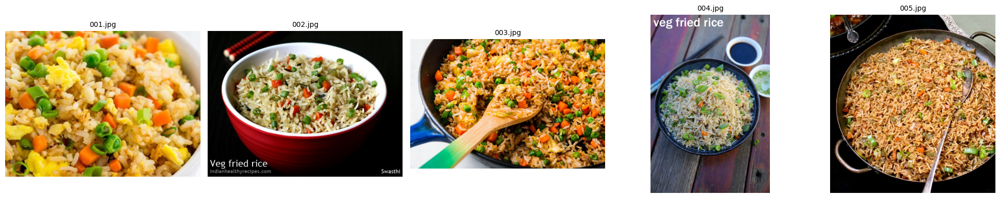

In [28]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/fried_rice"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

Fries

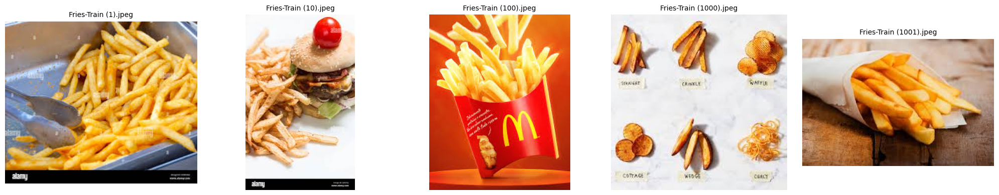

In [29]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/Fries"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

Hot Dog

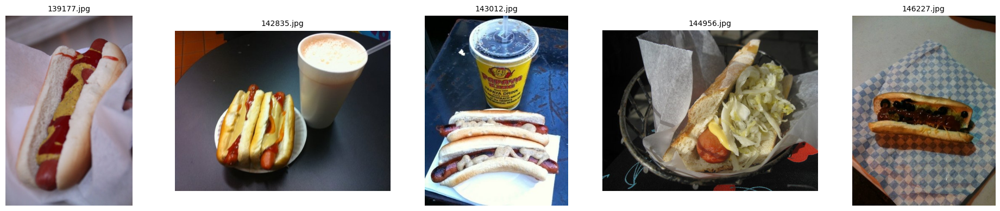

In [30]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/Hot Dog"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

ice_cream

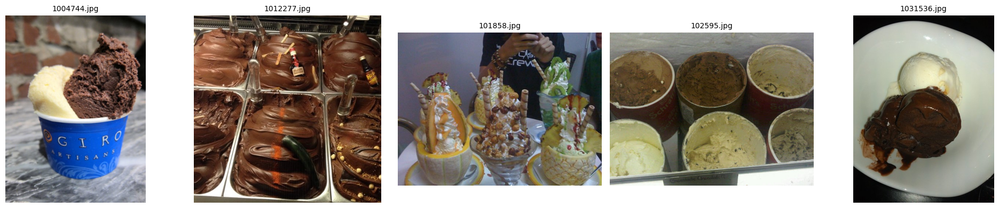

In [31]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/ice_cream"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

omelette

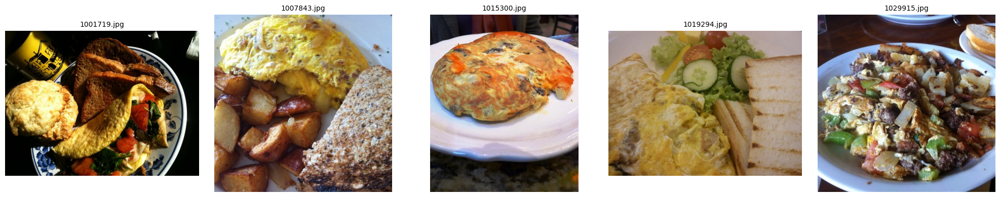

In [32]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/omelette"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

pizza

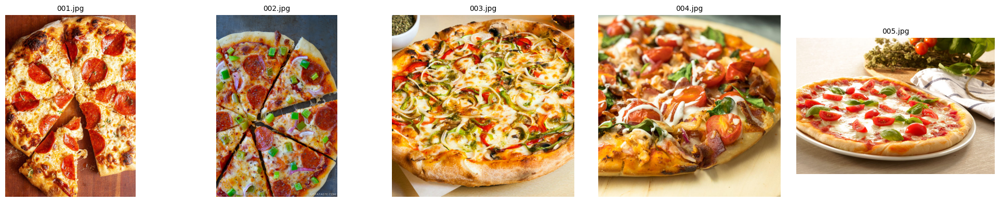

In [33]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/pizza"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

samosa

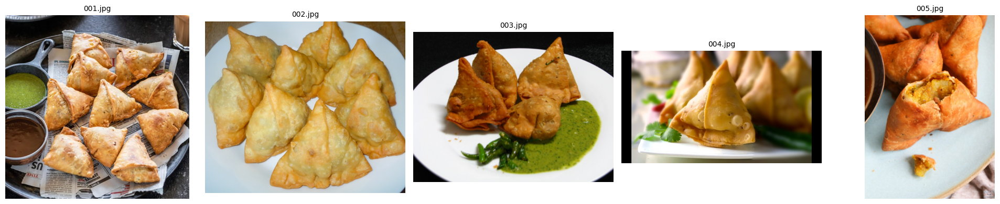

In [35]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/samosa"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

Sandwich

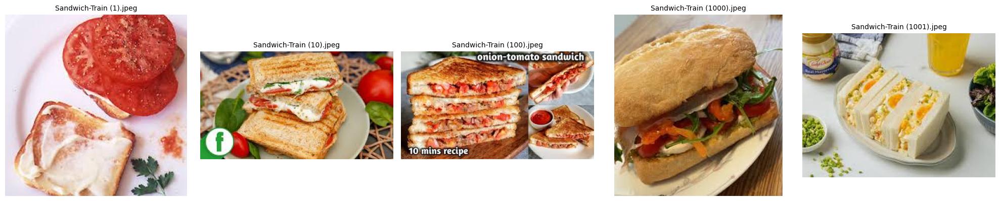

In [36]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/Sandwich"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

sushi

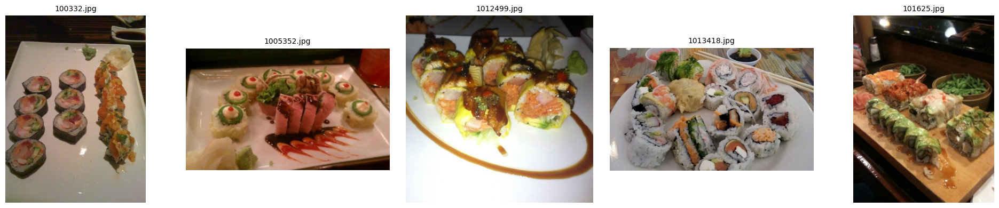

In [37]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/sushi"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

Taco

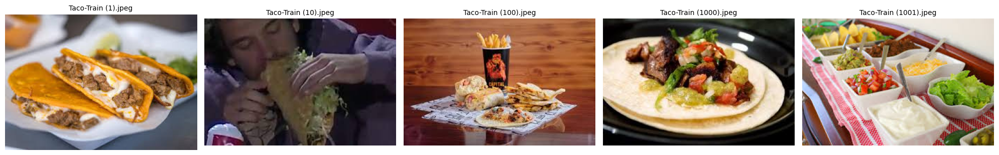

In [38]:
# Specify the path containing the images to visualize
path_to_visualize = "D:/Private/Prodigy InfoTech/Task 5/Train/Taco"

# Visualize some images from the specified path
visualize_images(path_to_visualize, num_images=5)

Build and Fit The Model


In [46]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense

# Load pretrained ResNet50 without the classification head
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224,3))
base_model.trainable = False

model = Sequential([
    base_model,
    GlobalAveragePooling2D(),
    Dense(128, activation='relu'),
    Dense(10, activation='softmax')  # adjust 10 to your number of classes
])

model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

model.summary()


ModuleNotFoundError: No module named 'keras.src.engine.base_layer_v1'

In [48]:
import tensorflow as tf
print(tf.__version__)
from tensorflow.keras.applications import ResNet50
model = ResNet50(weights='imagenet')
print("Model loaded successfully!")


2.15.0


ModuleNotFoundError: No module named 'keras.src.engine.base_layer_v1'